In [ ]:
from random import random
import torch
from monai.utils import set_determinism
from monai.networks.nets import UNet
from monai.networks.layers import Norm

from tqdm import tqdm
import os

import pandas as pd
from sklearn.model_selection import train_test_split

from utils.data_load import get_data_list, get_case_dataset_3d, get_test_case
from utils.transforms import get_3D_transforms
from utils.inference import get_case_predictions_3d, evaluate_predictions
from utils.viz import plot_predictions_3D, plot_test_slices

# from utils.viz import plot_predictions_3D, plot_test_slices
import numpy as np
import random

In [2]:
set_determinism(seed=42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device: {device}", flush=True)

Device: cuda


In [3]:
DATA_ROOT = "/scratch/cv-course2025/lschind5/kits19/data"
NUM_WORKERS = 4
MODEL_PATH = "/home/group.kurse/cviwo008/Project/"
MODEL_NAME = "kits19-model-3d-unet-V5.pth"

In [4]:
all_cases = get_data_list(DATA_ROOT)
print(f"   Found {len(all_cases)} cases", flush=True)

   Found 210 cases


In [5]:
train_data, val_data = train_test_split(
    all_cases, test_size=0.2, random_state=42
)

val_cases = [case["case_id"] for case in val_data]
test_cases = [f"case_{i:05d}" for i in range(210, 299)]

In [ ]:
model = UNet(
    spatial_dims=3,
    in_channels=1,
    out_channels=3,
    channels=(30, 60, 120, 240, 320),
    strides=(2, 2, 2, 2),
    num_res_units=3,
    act="PRELU",
    norm=Norm.INSTANCE,
    dropout=0.0,
    kernel_size=3,
    up_kernel_size=3
)

In [ ]:
checkpoint = torch.load(
    os.path.join(MODEL_PATH, MODEL_NAME), 
    map_location=device
)
model.load_state_dict(checkpoint)

model = model.to(device)

Version 2 of 3D transforms


In [ ]:
train_transforms, val_transforms = get_3D_transforms()

In [8]:
val_data = {}
for case in tqdm(val_cases):
    print(case)
            
    case_dataset, case_image, case_label = get_case_dataset_3d(
        case, DATA_ROOT, val_transforms, NUM_WORKERS
    )
    case_predictions = get_case_predictions_3d(model, case_dataset, device)
    
    val_data[case] = {
        "case_id": case,
        "image": case_image,           # Original NIfTI image for metadata
        "ground_truth": case_label,    # Transformed label tensor (same space as predictions)
        "predictions": case_predictions # Predictions tensor (same space as ground_truth)
    }

  0%|                                                                                                                                                                                     | 0/42 [00:00<?, ?it/s]

case_00030


  2%|████                                                                                                                                                                         | 1/42 [00:02<01:24,  2.07s/it]

case_00172


  5%|████████▏                                                                                                                                                                    | 2/42 [00:05<01:52,  2.81s/it]

case_00084


  7%|████████████▎                                                                                                                                                                | 3/42 [00:12<03:03,  4.71s/it]

case_00199


 10%|████████████████▍                                                                                                                                                            | 4/42 [00:15<02:35,  4.09s/it]

case_00060


 12%|████████████████████▌                                                                                                                                                        | 5/42 [00:19<02:31,  4.09s/it]

case_00155


 14%|████████████████████████▋                                                                                                                                                    | 6/42 [00:29<03:35,  5.99s/it]

case_00045


 17%|████████████████████████████▊                                                                                                                                                | 7/42 [00:31<02:43,  4.67s/it]

case_00182


 19%|████████████████████████████████▉                                                                                                                                            | 8/42 [00:35<02:30,  4.42s/it]

case_00009


 21%|█████████████████████████████████████                                                                                                                                        | 9/42 [00:37<02:07,  3.87s/it]

case_00196


 24%|████████████████████████████████████████▉                                                                                                                                   | 10/42 [00:42<02:16,  4.27s/it]

case_00136


 26%|█████████████████████████████████████████████                                                                                                                               | 11/42 [00:46<02:06,  4.08s/it]

case_00187


 29%|█████████████████████████████████████████████████▏                                                                                                                          | 12/42 [00:49<01:50,  3.68s/it]

case_00207


 31%|█████████████████████████████████████████████████████▏                                                                                                                      | 13/42 [00:54<01:56,  4.02s/it]

case_00126


 33%|█████████████████████████████████████████████████████████▎                                                                                                                  | 14/42 [00:58<01:56,  4.16s/it]

case_00015


 36%|█████████████████████████████████████████████████████████████▍                                                                                                              | 15/42 [01:01<01:37,  3.63s/it]

case_00073


 38%|█████████████████████████████████████████████████████████████████▌                                                                                                          | 16/42 [01:06<01:47,  4.15s/it]

case_00165


 40%|█████████████████████████████████████████████████████████████████████▌                                                                                                      | 17/42 [01:20<02:59,  7.20s/it]

case_00018


 43%|█████████████████████████████████████████████████████████████████████████▋                                                                                                  | 18/42 [01:24<02:25,  6.04s/it]

case_00168


 45%|█████████████████████████████████████████████████████████████████████████████▊                                                                                              | 19/42 [01:26<01:56,  5.05s/it]

case_00093


 48%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 20/42 [01:40<02:46,  7.59s/it]

case_00075


 50%|██████████████████████████████████████████████████████████████████████████████████████                                                                                      | 21/42 [01:43<02:11,  6.28s/it]

case_00055


 52%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 22/42 [01:47<01:52,  5.62s/it]

case_00147


 55%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 23/42 [01:50<01:32,  4.88s/it]

case_00109


 57%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 24/42 [01:52<01:13,  4.07s/it]

case_00108


 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 25/42 [01:55<01:00,  3.58s/it]

case_00142


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 26/42 [02:01<01:07,  4.23s/it]

case_00025


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 27/42 [02:03<00:57,  3.82s/it]

case_00125


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 28/42 [02:09<01:02,  4.44s/it]

case_00016


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 29/42 [02:14<00:57,  4.43s/it]

case_00173


 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 30/42 [02:18<00:50,  4.23s/it]

case_00192


 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 31/42 [02:22<00:47,  4.33s/it]

case_00069


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 32/42 [02:25<00:39,  3.95s/it]

case_00101


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 33/42 [02:39<01:03,  7.02s/it]

case_00067


 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 34/42 [02:45<00:53,  6.74s/it]

case_00104


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 35/42 [02:50<00:42,  6.05s/it]

case_00132


 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 36/42 [03:00<00:43,  7.19s/it]

case_00180


 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 37/42 [03:04<00:31,  6.21s/it]

case_00095


 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 38/42 [03:11<00:26,  6.52s/it]

case_00082


 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 39/42 [03:15<00:17,  5.69s/it]

case_00159


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 40/42 [03:27<00:15,  7.77s/it]

case_00197


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 41/42 [03:32<00:06,  6.94s/it]

case_00162


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [03:35<00:00,  5.13s/it]


In [ ]:
metrics_standard_nobg, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=False, exclude_background_slices=False)
metrics_slices, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=True, exclude_background_slices=False)
metrics_slices_nofp, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=True, exclude_background_slices=True)
metrics_slices_nobg, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=True, exclude_background_slices=True)
metrics_standard, val_with_scores = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=False, exclude_background_slices=False)

In [10]:
metrics_standard_nobg

{'kidney_dice': 0.9634660326299214,
 'tumor_dice': 0.8172400571583283,
 'bg_dice': 0.9993962134633746,
 'note': 'False positives excluded from DICE calculation',
 'evaluation_mode': 'case-wise (3D)'}

In [11]:
metrics_slices

{'kidney_dice': 0.0,
 'tumor_dice': 0.0,
 'bg_dice': 1.9902798164458502,
 'evaluation_mode': 'slice-wise (2D)'}

In [12]:
metrics_slices_nofp

{'kidney_dice': 0.0,
 'tumor_dice': 0.0,
 'bg_dice': 0.9995769929318201,
 'note': 'False positives excluded from DICE calculation; Background-only slices excluded from calculation',
 'evaluation_mode': 'slice-wise (2D)'}

In [13]:
metrics_slices_nobg

{'kidney_dice': 0.0,
 'tumor_dice': 0.0,
 'bg_dice': 0.9995769929318201,
 'note': 'False positives excluded from DICE calculation; Background-only slices excluded from calculation',
 'evaluation_mode': 'slice-wise (2D)'}

In [14]:
metrics_standard

{'kidney_dice': 0.8816331114087786,
 'tumor_dice': 0.6062623018141104,
 'bg_dice': 0.9990498849323818,
 'evaluation_mode': 'case-wise (3D)'}

Plotting case_00142: GT shape (257, 207, 160), Pred shape (257, 207, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


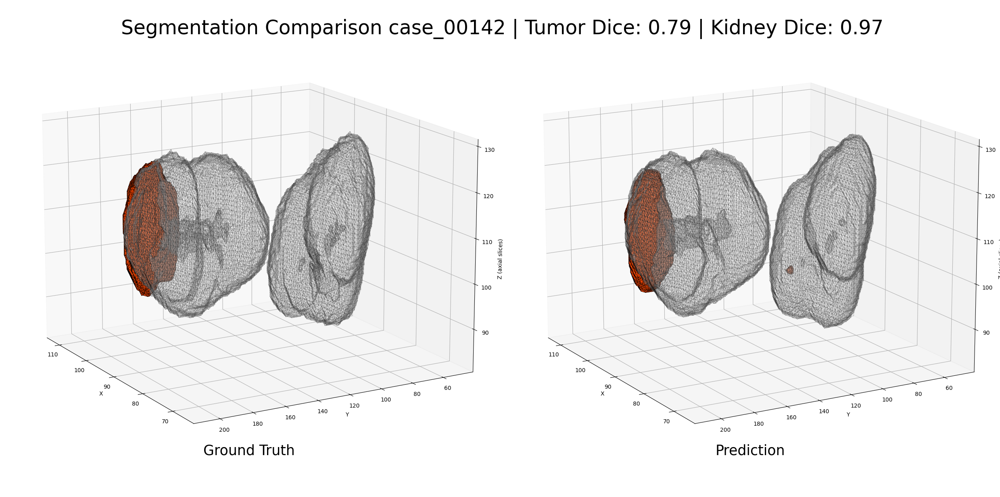

Plotting case_00165: GT shape (319, 269, 249), Pred shape (319, 269, 249)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


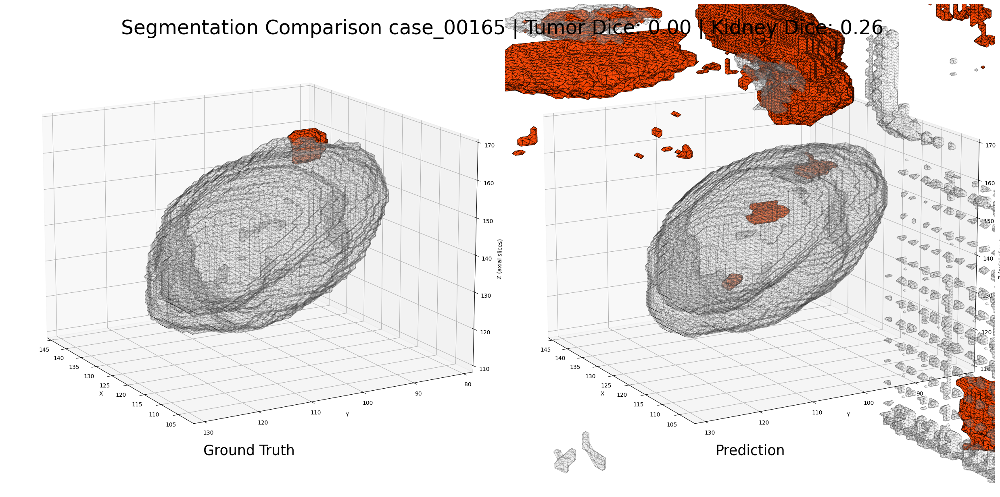

Plotting case_00197: GT shape (269, 246, 171), Pred shape (269, 246, 171)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


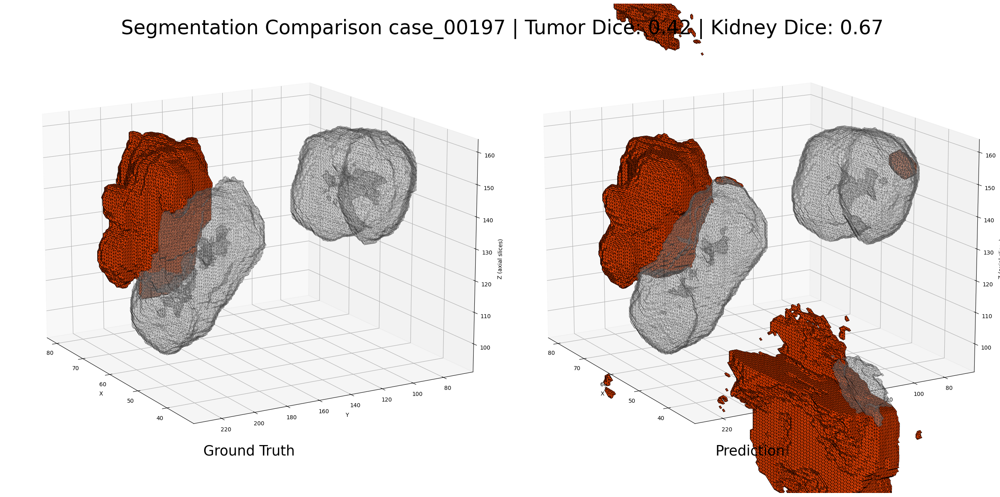

Plotting case_00067: GT shape (258, 201, 160), Pred shape (258, 201, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


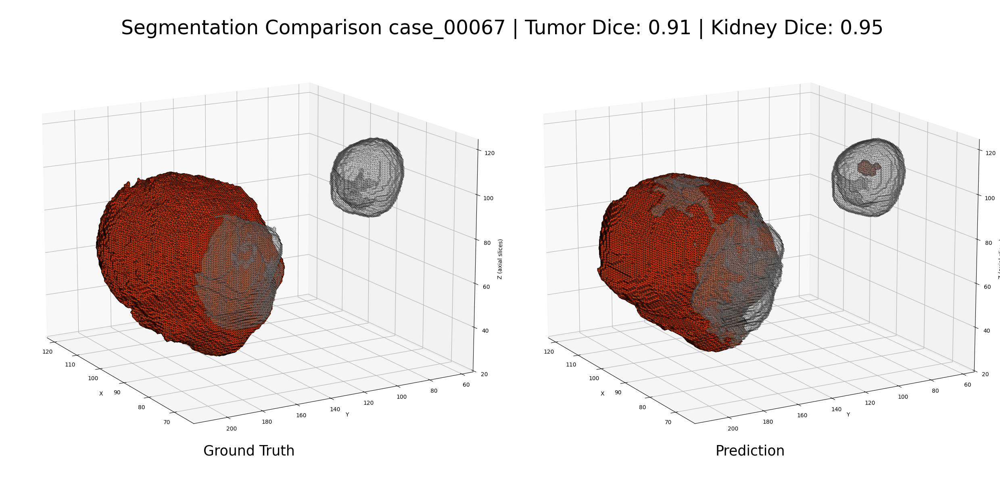

Plotting case_00196: GT shape (233, 179, 186), Pred shape (233, 179, 186)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


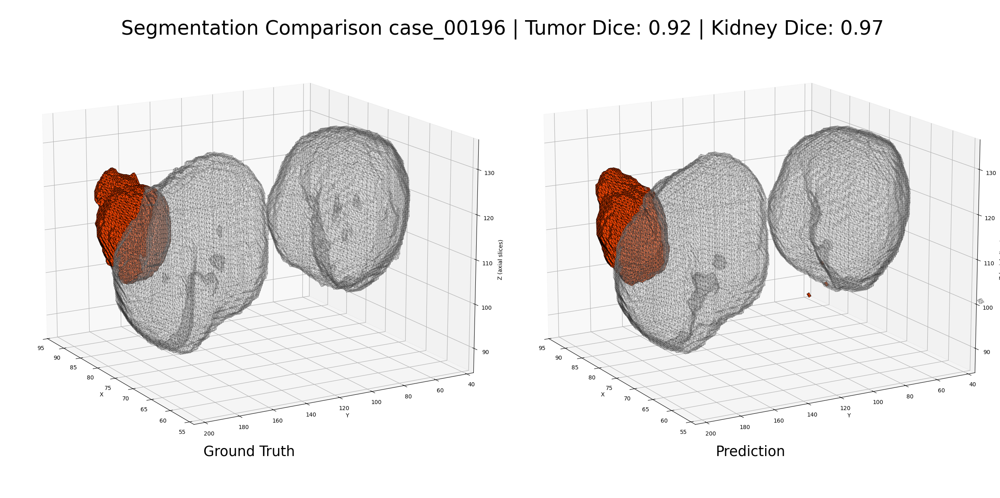

Plotting case_00075: GT shape (244, 198, 160), Pred shape (244, 198, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


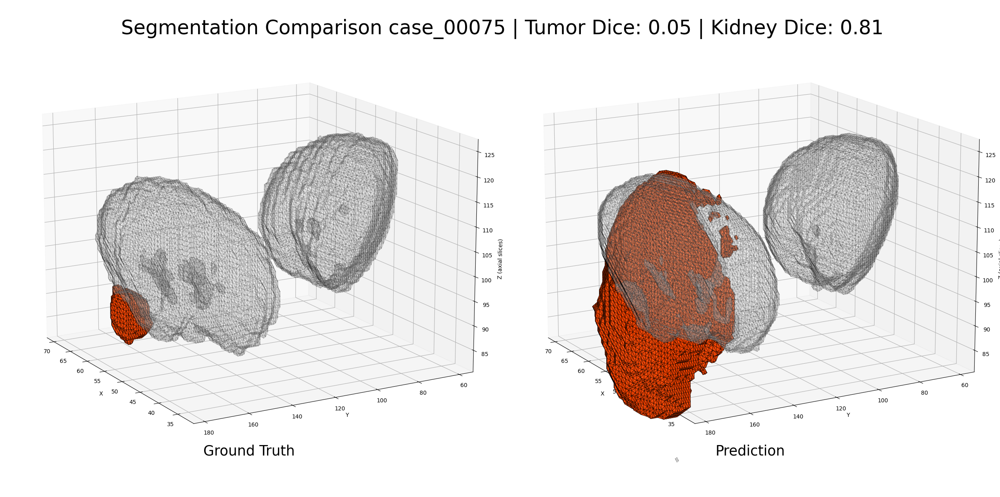

Plotting case_00172: GT shape (219, 179, 161), Pred shape (219, 179, 161)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


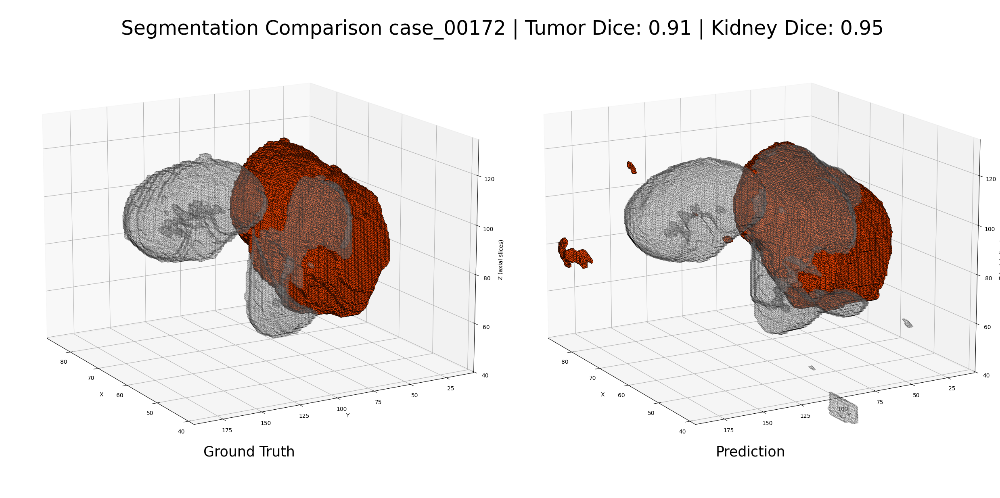

Plotting case_00101: GT shape (263, 193, 160), Pred shape (263, 193, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


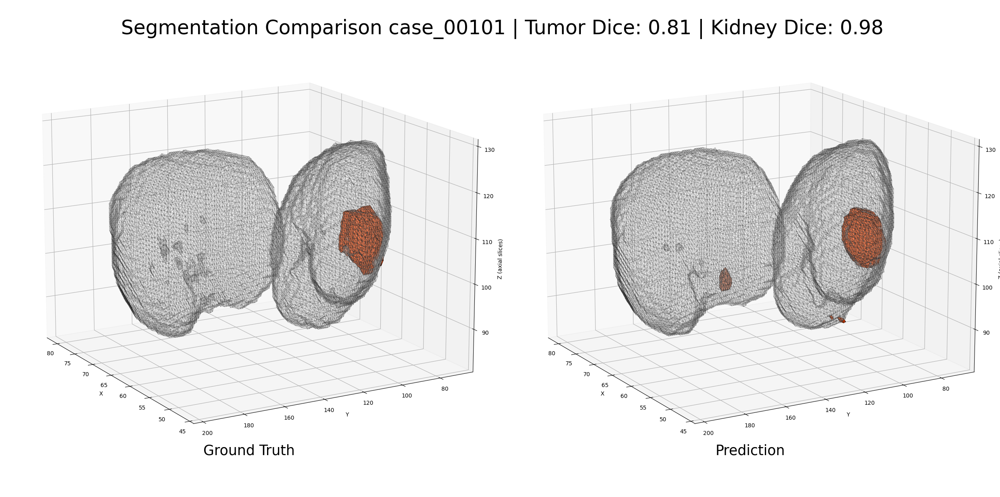

Plotting case_00109: GT shape (204, 160, 160), Pred shape (204, 160, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


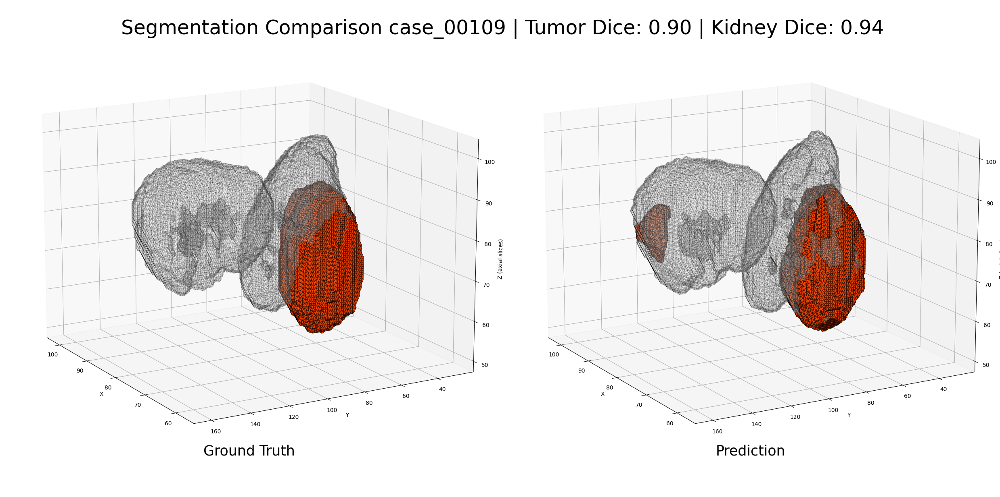

Plotting case_00015: GT shape (243, 205, 160), Pred shape (243, 205, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


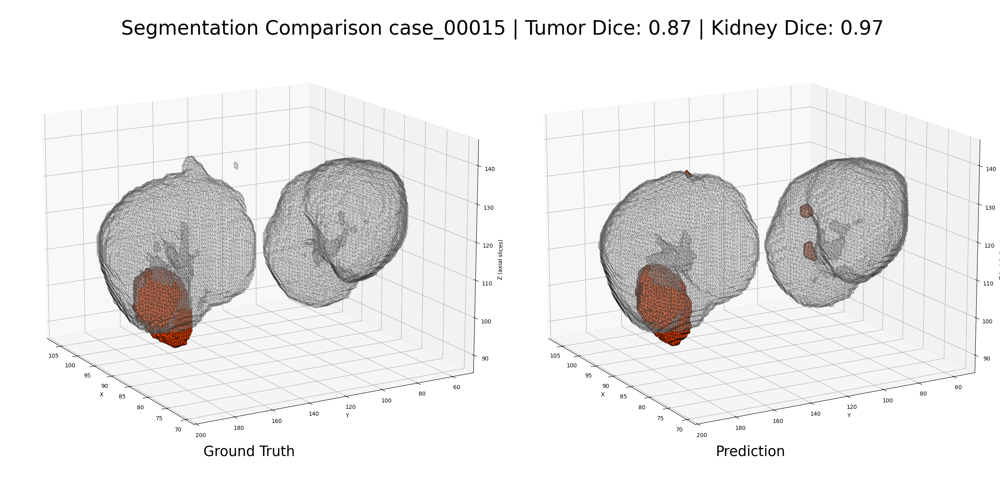

Plotting case_00126: GT shape (297, 262, 186), Pred shape (297, 262, 186)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


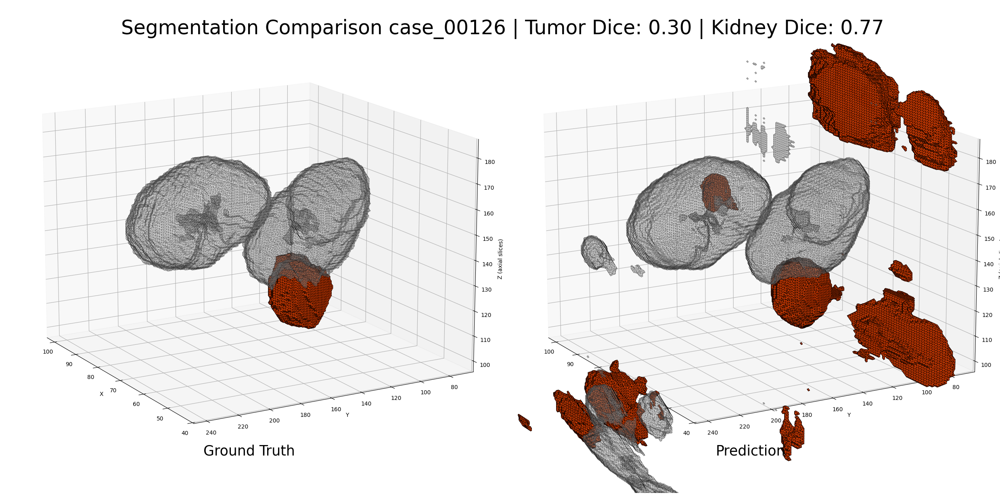

Plotting case_00125: GT shape (284, 228, 179), Pred shape (284, 228, 179)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


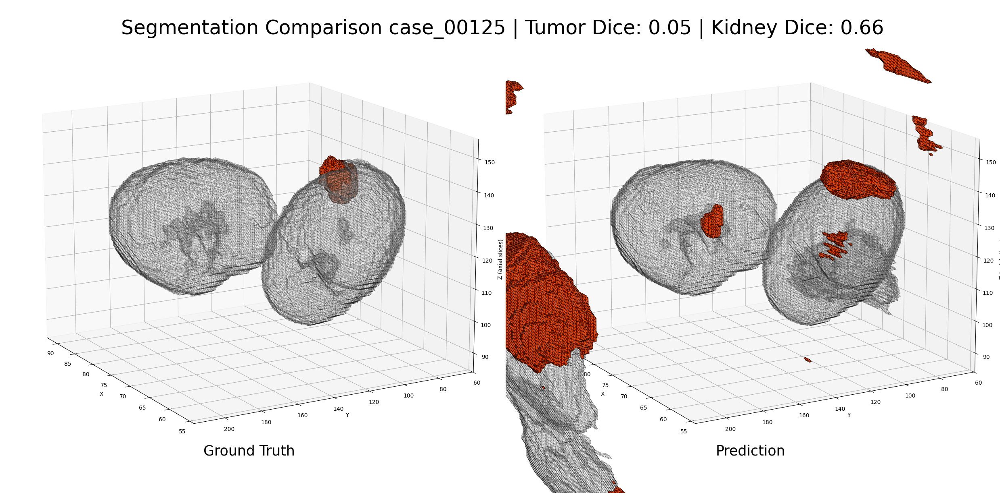

Plotting case_00192: GT shape (255, 212, 226), Pred shape (255, 212, 226)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


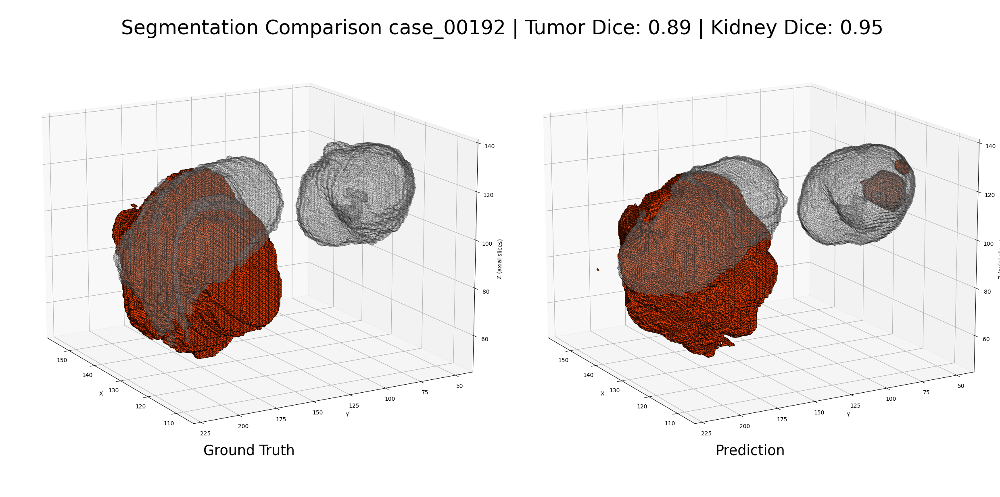

Plotting case_00093: GT shape (308, 273, 160), Pred shape (308, 273, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


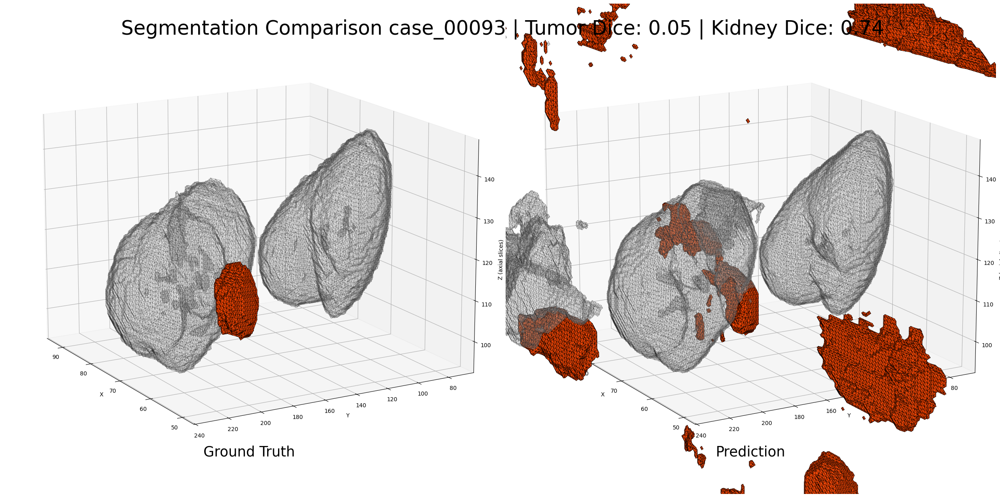

Plotting case_00132: GT shape (246, 187, 160), Pred shape (246, 187, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


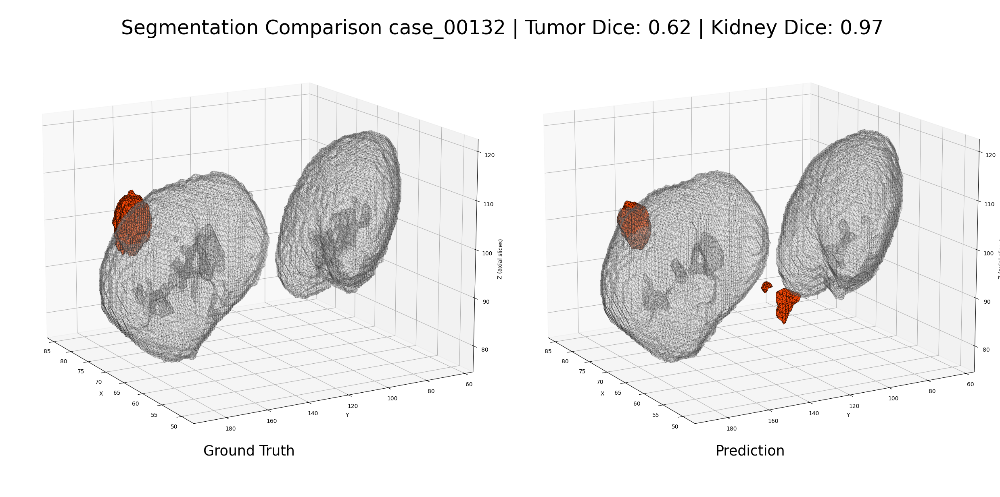

Plotting case_00082: GT shape (267, 199, 160), Pred shape (267, 199, 160)
Applying 3D U-Net orientation (C7)...
Applying 3D U-Net orientation (C7)...


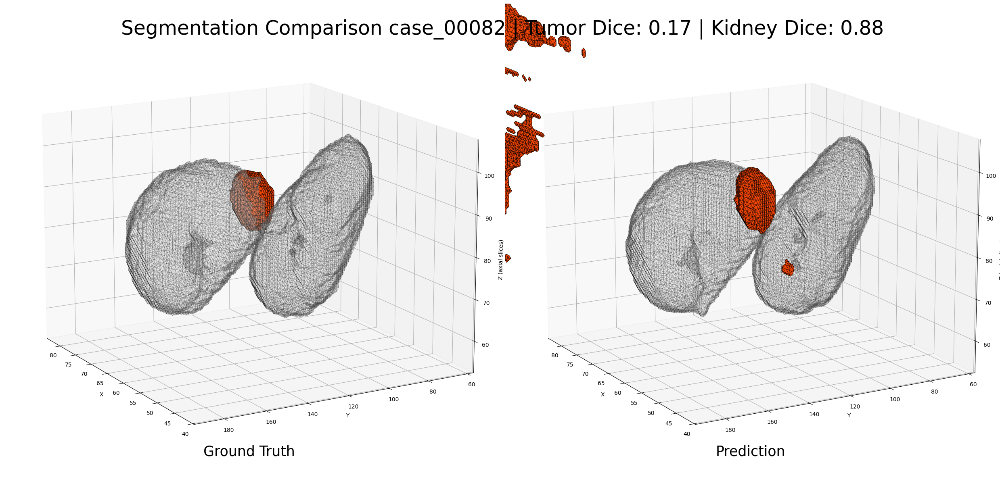

NameError: name 'get_2D_test_transforms' is not defined

In [ ]:
# select cases: good kidney dice, bad kidney dice, good tumor dice, bad tumor dice
# sort cases by kidney dice
sorted_cases_kidney = sorted(val_with_scores.items(), key=lambda x: x[1]["kidney_dice"], reverse=True)
sorted_cases_tumor = sorted(val_with_scores.items(), key=lambda x: x[1]["tumor_dice"], reverse=True)

# select best and worst cases
best_kidney_cases = [case_id for case_id, data in sorted_cases_kidney[:5]]  # Top 5 kidney cases
worst_kidney_cases = [case_id for case_id, data in sorted_cases_kidney[-5:]]  # Bottom 5 kidney cases
best_tumor_cases = [case_id for case_id, data in sorted_cases_tumor[:5]]  # Top 5 tumor cases
worst_tumor_cases = [case_id for case_id, data in sorted_cases_tumor[-5:]]  # Bottom 5 tumor cases

# Combine all selected case IDs into a single set (removes duplicates)
selected_case_ids = set(best_kidney_cases + worst_kidney_cases + best_tumor_cases + worst_tumor_cases)
selected_val_data = {case_id: val_with_scores[case_id] for case_id in selected_case_ids}

plot_predictions_3D(selected_val_data, output_path=os.path.join(MODEL_PATH, "results", "comparison"), model_type="3d")

# plot random test predictions
random_test_cases = random.sample(test_cases, 25)
test_transforms = get_2D_test_transforms()
test_data = {}
for case in random_test_cases:
    case_dataset, case_image = get_test_case(case, DATA_ROOT, test_transforms, NUM_WORKERS)
    case_predictions = get_case_predictions(model, case_dataset, device)
    test_data[case] = {
        "case_id": case,
        "image": case_image,
        "predictions": case_predictions
    }

plot_test_slices(test_data, slice_selection='evenly_spaced', output_path=os.path.join(MODEL_PATH, "results", "slices"))